In [398]:
import numpy as np
import math as m
import matplotlib;
import matplotlib.pyplot as plt

from __future__ import division
from pyomo.environ import *
from pyomo.util.infeasible import log_infeasible_constraints
from coopr.pyomo import *
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML

In [399]:
# Initialization of concrete model
model = ConcreteModel()

In [400]:
# Problem Set-up
case = 4

if case != 4:
    n_flights = 2
else:
    n_flights = 8
    case = 1
    

F = np.linspace(1,n_flights, n_flights).astype(int)
F = F.astype(str)

for i,f in enumerate(F):
    F[i] = 'f' + f

model.F = Set(initialize=F,ordered=True)

Data = {F[0]: {}, F[1]: {}}
scale = 100000

# This function is just to define the initial/final position X, Y, angle and the Initial Velocity of the aircraft
def InitialData(angle, scale):
    R=100000
    return  {'xI': R*(1-0.5*m.cos(angle))/scale, 'xF': R*(1+0.5*m.cos(angle))/scale,
             'yI': R*(1-0.5*m.sin(angle))/scale, 'yF': R*(1+0.5*m.sin(angle))/scale,
                  'vI': 200/scale, 'chiI': angle, 'chiF': angle}

angles = []
if n_flights==2:
    angles = [m.pi / 2, 0]
else:
    ang_dif = 2*m.pi/n_flights
    for i in range(0,n_flights):
        angles.append(i*ang_dif)

for index, angle in enumerate(angles):
    Data[F[index]] = InitialData(angle, scale)

n_it = 500 # Discrete Samples
dt_extra=10

T = np.linspace(0,n_it,n_it+1).astype(int)

V_Stall={}
V_Max={}

a_Min={}
a_Max={}

chi_Min={}
chi_Max={}

for i,f in enumerate(F):
    V_Stall[F[i]] = 150/scale
    V_Max[F[i]] = 250/scale

    a_Min[F[i]] = -5/scale
    a_Max[F[i]] = 5/scale

    chi_Min[F[i]] = Data[F[i]]['chiI'] - 60*m.pi/180
    chi_Max[F[i]] = Data[F[i]]['chiI'] + 60*m.pi/180

r_min = 9260/scale

print(Data)

{np.str_('f1'): {'xI': 0.5, 'xF': 1.5, 'yI': 1.0, 'yF': 1.0, 'vI': 0.002, 'chiI': 0.0, 'chiF': 0.0}, np.str_('f2'): {'xI': 0.6464466094067263, 'xF': 1.3535533905932737, 'yI': 0.6464466094067263, 'yF': 1.3535533905932737, 'vI': 0.002, 'chiI': 0.7853981633974483, 'chiF': 0.7853981633974483}, np.str_('f3'): {'xI': 1.0, 'xF': 1.0, 'yI': 0.5, 'yF': 1.5, 'vI': 0.002, 'chiI': 1.5707963267948966, 'chiF': 1.5707963267948966}, np.str_('f4'): {'xI': 1.3535533905932737, 'xF': 0.6464466094067263, 'yI': 0.6464466094067263, 'yF': 1.3535533905932737, 'vI': 0.002, 'chiI': 2.356194490192345, 'chiF': 2.356194490192345}, np.str_('f5'): {'xI': 1.5, 'xF': 0.5, 'yI': 0.9999999999999999, 'yF': 1.0, 'vI': 0.002, 'chiI': 3.141592653589793, 'chiF': 3.141592653589793}, np.str_('f6'): {'xI': 1.3535533905932742, 'xF': 0.6464466094067262, 'yI': 1.3535533905932737, 'yF': 0.6464466094067263, 'vI': 0.002, 'chiI': 3.9269908169872414, 'chiF': 3.9269908169872414}, np.str_('f7'): {'xI': 1.0, 'xF': 0.9999999999999999, 'yI':

In [401]:
# Define the set of Times for the problem
model.T        = Set(initialize=T, ordered=True)
model.n_it     = Param(initialize=n_it)
model.dt_extra = Param(initialize=dt_extra)

model.T.pprint()

T : Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :  501 : {np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41), np.int64(42), np.int64(43), np.int64(44), np.int64(45), np.int64(46), np.int64(47), np.int64(48), np.int64(49), np.int64(50), np.int64(51), np.int64(52), np.int64(53), np.int64(54), np.int64(55), np.int64(56), np.int64(57), np.int64(58), np.int64(59), np.int64(60), np.int64(61), np.int64(62), np.int6

Parameter Definition

In [402]:
# Define the Parameters of the problem in the OPT model.

# Initial and Final Positions and Headings
model.x0    = Param(model.F, initialize={f: Data[f]['xI'] for f in model.F})
model.xf    = Param(model.F, initialize={f: Data[f]['xF'] for f in model.F})

model.y0    = Param(model.F, initialize={f: Data[f]['yI'] for f in model.F})
model.yf    = Param(model.F, initialize={f: Data[f]['yF'] for f in model.F})

model.chi0  = Param(model.F, initialize={f: Data[f]['chiI'] for f in model.F})
model.chif  = Param(model.F, initialize={f: Data[f]['chiF'] for f in model.F})

# Initial Velocities
model.v0    = Param(model.F, initialize={f: Data[f]['vI'] for f in model.F})

# Define the flight envelope parameters                                     
model.V_stall   = Param(model.F, initialize=V_Stall)
model.V_max     = Param(model.F, initialize=V_Max)

model.a_min     = Param(model.F, initialize=a_Min)
model.a_max     = Param(model.F, initialize=a_Max)

model.chi_min   = Param(model.F, initialize=chi_Min)
model.chi_max   = Param(model.F, initialize=chi_Max)

model.r_min = Param(initialize=r_min)

In [403]:
# Define the Variables of the problem in the OPT model.
model.x   = Var(model.F, model.T, within=Reals)
model.y   = Var(model.F, model.T, within=Reals)

model.v   = Var(model.F, model.T, within=NonNegativeReals)
model.a   = Var(model.F, model.T, within=Reals)

model.chi = Var(model.F, model.T, within=Reals)
model.ft  = Var(model.F, within=NonNegativeReals)

In [404]:
# tolerances
epsilon = 3/scale
epsilon_angle = 3*m.pi/180

In [405]:
# Initial Conditions
def init_x(model, f):
    return model.x[f, 0] == model.x0[f]

def final_upper_x(model, f, epsilon=3/scale):
    return model.x[f, model.n_it] <= model.xf[f] + epsilon

def final_lower_x(model, f, epsilon=3/scale):
    return model.x[f, model.n_it] >= model.xf[f] - epsilon

def dynamics_x_eq(model, f, t):
    if t < list(model.T)[-1]:
      model.t_step = model.ft[f]/(model.n_it-1)
      return model.x[f, t+1] == model.x[f, t] + model.v[f, t]*cos(model.chi[f, t])*model.t_step 
    
    else:
      return Constraint.Skip

X Constraints

In [406]:
model.init_x_Constraint        = Constraint(model.F, rule=init_x)
model.final_upper_x_Constraint = Constraint(model.F, rule=final_upper_x)
model.final_lower_x_Constraint = Constraint(model.F, rule=final_lower_x)
model.dynamics_x_eq_Constraint = Constraint(model.F, model.T, rule=dynamics_x_eq)

Y Constraints

In [407]:
def init_y(model, f):
    return model.y[f, 0] == model.y0[f]

def final_upper_y(model, f, tol=3/scale):
    return model.y[f, model.n_it] <= model.yf[f] + tol

def final_lower_y(model, f, tol=3/scale):
    return model.y[f, model.n_it] >= model.yf[f] - tol

def dynamics_y_eq(model, f, t):
    if t < list(model.T)[-1]:
      model.t_step = model.ft[f]/(model.n_it-1)

      return model.y[f, t+1] == model.y[f, t] + model.v[f, t]*sin(model.chi[f, t])*model.t_step 
    
    else:
      return Constraint.Skip

In [408]:
model.init_y_Constraint        = Constraint(model.F, rule=init_y)
model.final_upper_y_Constraint = Constraint(model.F, rule=final_upper_y)
model.final_lower_y_Constraint = Constraint(model.F, rule=final_lower_y)
model.dynamics_y_eq_Constraint = Constraint(model.F, model.T, rule=dynamics_y_eq)

V Constraints

In [409]:
def init_v(model, f):
    return model.v[f, 0] == model.v0[f]

def const_lower_v(model, f, t):
    return model.v[f, t] >= model.V_stall[f]

def const_upper_v(model, f, t):
    return model.v[f, t] <= model.V_max[f]

def dynamics_v_eq(model, f, t):
    if t < list(model.T)[-1]:
        model.t_step = model.ft[f]/(model.n_it-1)

        return model.v[f, t+1] == model.v[f, t] + model.a[f, t]*model.t_step 
    
    else:
        return Constraint.Skip

In [410]:
model.init_v_Constraint        = Constraint(model.F, rule=init_v)
model.const_lower_v_Constraint = Constraint(model.F, model.T, rule=const_upper_v)
model.const_upper_v_Constraint = Constraint(model.F, model.T, rule=const_lower_v)
model.dynamics_v_eq_Constraint = Constraint(model.F, model.T, rule=dynamics_v_eq)

Chi Constraints

In [411]:
def init_chi(model, f):
    return model.chi[f, 0] == model.chi0[f]

def const_lower_chi(model, f, t):
    return model.chi[f, t] >= model.chi_min[f]

def const_upper_chi(model, f, t):
    return model.chi[f, t] <= model.chi_max[f]

def final_upper_chi(model, f, epsilon=0.01):
    return model.chi[f, n_it] <= model.chif[f] + epsilon

def final_lower_chi(model, f, epsilon=0.01):
    return model.chi[f, n_it] >= model.chif[f] - epsilon 

In [412]:
model.init_chi_Constraint        = Constraint(model.F,          rule=init_chi)
model.const_lower_chi_Constraint = Constraint(model.F, model.T, rule=const_upper_chi)
model.const_upper_chi_Constraint = Constraint(model.F, model.T, rule=const_lower_chi)

model.final_upper_chi_Constraint = Constraint(model.F, rule=final_upper_chi)
model.final_lower_chi_Constraint = Constraint(model.F, rule=final_lower_chi)

a Constraints

In [413]:
def const_upper_a(model, f, t):
    return model.a[f, t] >= model.a_min[f]

def const_lower_a(model, f, t):
    return model.a[f, t] <= model.a_max[f]


In [414]:
model.const_upper_a_Constraint = Constraint(model.F, model.T, rule=const_upper_a)
model.const_lower_a_Constraint = Constraint(model.F, model.T, rule=const_lower_a)

Conflict Avoidance Constraint

In [415]:
def conflict_avoidance(model, f, fp, t):
    return ((model.x[f, t] - model.x[fp, t])**2 +
            (model.y[f, t] - model.y[fp, t])**2) >= model.r_min**2

In [416]:
model.F_pairs = Set(
    initialize=[(f1, f2) for i, f1 in enumerate(model.F)
                         for j, f2 in enumerate(model.F)
                         if i < j],
    dimen=2
)

model.conflict_avoidance_Constraint = Constraint(model.F_pairs, model.T, rule=conflict_avoidance)

Objective Function

In [417]:
# ONLY CHANGE HEADING
if case == 1:
    print("Selected case 1: Variation on Heading")
    def constant_v_objective_func(model):
        """
        Minimizes the heading (chi) variation, with a constant v
        """
        return sum( (model.chi[f, t] - model.chi[f, t-1])**2
                for f in model.F
                for t in model.T if t > 0)

    def constant_velocity_rule(model, f, t):
        if t < max(model.T):
            return model.v[f, t+1] == model.v[f, t]
        else:
            return Constraint.Skip
        
    model.const_v = Constraint(model.F, model.T, rule=constant_velocity_rule)

    model.obj_func = Objective(rule=constant_v_objective_func, sense=minimize)


# ONLY CHANGE VELOCITY
elif case == 2:
    print("Selected case 2: Variation on Velocity")

    def constant_heading_objective_func(model):
        """
        Minimizes the velocity (v) variation, with a constant chi
        """
        return sum( (model.v[f, t] - model.v[f, t-1])**2
                for f in model.F
                for t in model.T if t > 0)
    
    def constant_heading_rule(model, f, t):
        if t < max(model.T):
            return model.chi[f, t+1] == model.chi[f, t]
        else:
            return Constraint.Skip
        
    model.const_chi = Constraint(model.F, model.T, rule=constant_heading_rule)

    model.obj_func = Objective(rule=constant_heading_objective_func, sense=minimize)


# FREE CHANGE FOR VELOCITY AND HEADING
elif case == 3:
    print("Selected case 3: Variation on Velocity and Heading")

    # The next parameter sets the influence of the Velocity, the higher the numberthe  higher the influence of the velocity for the obj func
    model.weight = Param(initialize=0.99995, mutable=True) 

    def free_objective_func(model):
        """
        Minimizes the velocity (v) and heading (chi) variation by setting them both freely
        """
        v_term =  sum((model.v[f, t] - model.v[f, t-1])**2
                       for f in model.F
                       for t in model.T if t > 0)
        
        chi_term = sum((model.chi[f, t] - model.chi[f, t-1])**2
                       for f in model.F
                       for t in model.T if t > 0)
        
        return (model.weight*v_term + (1-model.weight)*chi_term)
        
    model.obj_func = Objective(rule=free_objective_func, sense=minimize)


Selected case 1: Variation on Heading


In [418]:
for f in model.F:
    # for t == 0 use the each var's init data
    model.x[f, 0]    = model.x0[f]
    model.y[f, 0]    = model.y0[f]
    model.v[f, 0]    = model.v0[f]
    model.chi[f, 0]  = model.chi0[f]
    model.a[f, 0]    = 0.0
    model.ft[f]      = 500

    dt = model.ft[f].value / n_it

    # For each other t base the position on the previous position, velocity and heading
    # heading will be close to the initial one (hopefully)
    # acceleration set on 0 as a/c will accelerate or decelerate
    
    for t in model.T:
        if t == 0:
            continue

        model.x[f, t].value = model.x[f, t-1] + model.v[f, t-1] * cos(model.chi[f, t-1]) * dt
        model.y[f, t].value = model.y[f, t-1] + model.v[f, t-1] * sin(model.chi[f, t-1]) * dt
        model.v[f, t].value = model.v[f, t-1] + model.a[f, t-1] * dt

        model.chi[f, t].value = model.chi0[f]
        model.a[f, t].value    = 0.0


def final_time_constraint(model, f):
    return model.ft[f] >= 500

model.final_time_constraint = Constraint(model.F, rule=final_time_constraint)

In [419]:
# Solver
opt = SolverFactory("ipopt")
opt.options['print_level'] = 5
#opt.options['halt_on_ampl_error'] = 'yes'
#opt.options['tol'] = 1e-20
#opt.options['constr_viol_tol'] = 1e-20
#opt.options['acceptable_constr_viol_tol'] = 1e-15
opt.options['warm_start_init_point']='yes'
results = opt.solve(model, tee=True)

Ipopt 3.14.19: print_level=5
warm_start_init_point=yes


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.19, running with linear solver MUMPS 5.8.0.

Number of nonzeros in equality constraint Jacobian...:    64032
Number of nonzeros in inequality constraint Jacobian.:    80216
Number of nonzeros in Lagrangian Hessian.............:    60080

Total number of variables............................:    20048
                     variables with only lower bounds:     4016
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints

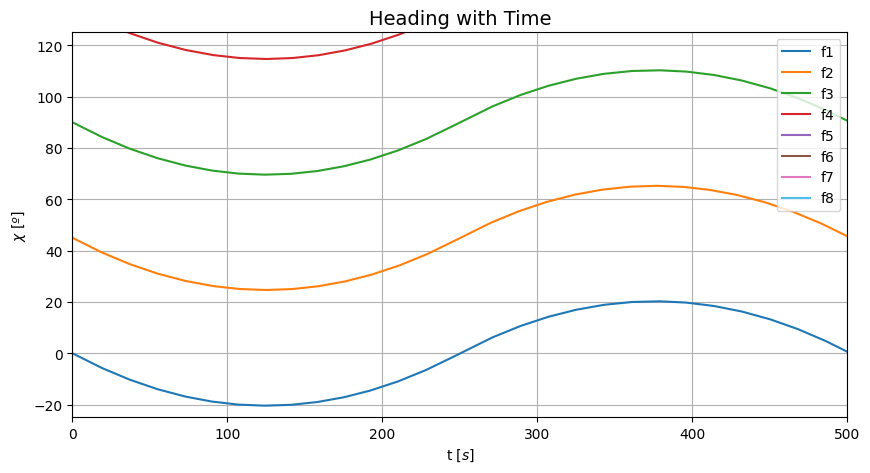

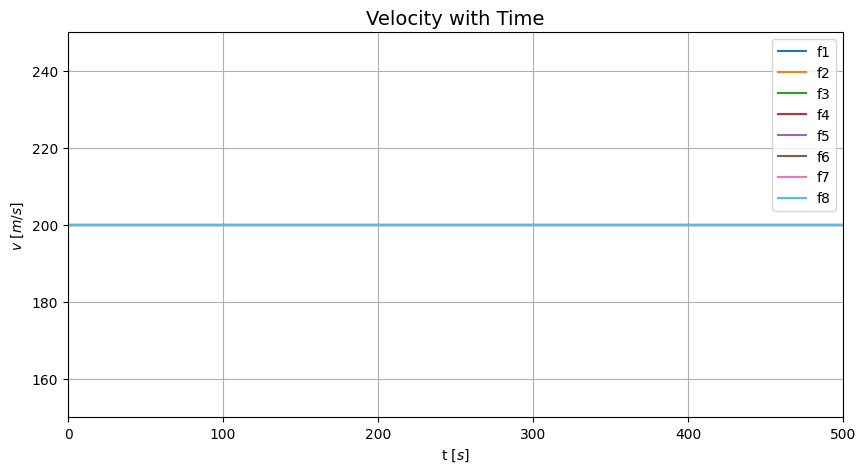

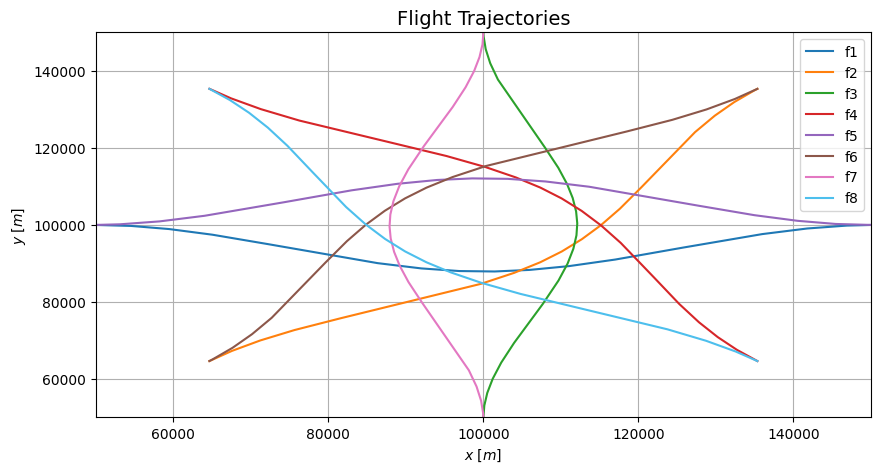

In [ ]:
plt.style.use('fast') 

colors = [
    (0.12, 0.47, 0.71),  # azul medio
    (1.00, 0.50, 0.05),  # naranja fuerte
    (0.17, 0.63, 0.17),  # verde
    (0.84, 0.15, 0.16),  # rojo intenso
    (0.58, 0.40, 0.74),  # violeta
    (0.55, 0.34, 0.29),  # marrón
    (0.89, 0.47, 0.76),  # rosa
    (0.30, 0.75, 0.93)   # celeste
]

fig1, ax1 = plt.subplots(figsize=(10, 5))
for i, f in enumerate(model.F):
    plot_chi = [np.degrees(model.chi[f, t]()) for t in model.T]
    ax1.plot(model.T, plot_chi, label=f"{f}", color=colors[i % len(colors)])

ax1.set_xlabel(r't [$s$]', fontsize=10)
ax1.set_ylabel(r'$\chi$ [$º$]', fontsize=10)
ax1.set_ylim((-25, 125))
ax1.set_xlim((0, 500))
ax1.legend(loc='upper right')
ax1.set_title("Heading with Time", fontsize=14)
ax1.grid(True)

# --- Velocity vs Time ---
fig2, ax2 = plt.subplots(figsize=(10, 5))
for i, f in enumerate(model.F):
    plot_v = [model.v[f, t]() * scale for t in model.T]
    ax2.plot(model.T, plot_v, label=f"{f}", color=colors[i % len(colors)])

ax2.set_xlabel(r't [$s$]', fontsize=10)
ax2.set_ylabel(r'$v$ [$m/s$]', fontsize=10)
ax2.set_ylim((150, 250))
ax2.set_xlim((0, 500))
ax2.legend(model.F, loc='upper right')
ax2.set_title("Velocity with Time", fontsize=14)
ax2.grid(True)

# --- Flight trajectories ---
fig3, ax3 = plt.subplots(figsize=(10, 5))
for i, f in enumerate(model.F):
    plot_x = [model.x[f, t]() * scale for t in model.T]
    plot_y = [model.y[f, t]() * scale for t in model.T]
    ax3.plot(plot_x, plot_y, label=f"{f}", color=colors[i % len(colors)])

ax3.set_xlabel(r'$x$ [$m$]', fontsize=10)
ax3.set_ylabel(r'$y$ [$m$]', fontsize=10)
ax3.set_ylim((50000, 150000))
ax3.set_xlim((50000, 150000))
ax3.legend(model.F, loc='upper right')
ax3.set_title("Flight Trajectories", fontsize=14)
ax3.grid(True)

plt.show()

In [422]:
matplotlib.rcParams['animation.embed_limit'] = 100

plt.style.use('fast')
plt.close('all')

# --- Figura y ejes ---
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim([50000, 150000])
ax.set_ylim([50000, 150000])
ax.set_xlabel('$x$  $(m)$')
ax.set_ylabel('$y$  $(m)$')
ax.set_title('Aircraft Trajectories')
ax.grid(True)

colors = ['royalblue', 'darkorange', 'forestgreen', 'crimson', 'mediumpurple', 'saddlebrown', 'hotpink', 'deepskyblue']


def animation(ii):
    ax.clear()
    ax.set_xlim([50000, 150000])
    ax.set_ylim([50000, 150000])
    ax.set_xlabel('$x$  $(m)$')
    ax.set_ylabel('$y$  $(m)$')
    ax.set_title(f'Aircraft Trajectories (t = {ii}s)')
    ax.grid(True)

    for j in range(n_flights):
        # Trajectory
        ax.plot(
            [model.x[F[j], k].value * scale for k in range(ii+1)],
            [model.y[F[j], k].value * scale for k in range(ii+1)],
            color=colors[j],
        )

        # Current Position
        ax.scatter(
            model.x[F[j], ii].value * scale,
            model.y[F[j], ii].value * scale,
            color=colors[j],
            marker='o',
            s=25,
            label=F[j],
        )

        # Separation Circle
        circ = plt.Circle((model.x[F[j], ii].value * scale, model.y[F[j], ii].value * scale),
                           radius=9260 / 2,
                           color=colors[j],
                           fill=False
        )
        ax.add_patch(circ)

    ax.legend(loc='upper right')

# --- Crear la animación ---
anim = FuncAnimation(fig,
                     animation,
                     frames=len(model.T),
                     interval=30)

plt.close(fig)
HTML(anim.to_jshtml())